## WMM lab 7 - 13.05.2025 godz. 13:15

Aleksander Paliwoda 331 419

# Analiza obrazu - detekcja twarzy

Do realizacji zadań wykorzystywane są biblioteki OpenCV, dlib oraz InsightFace (wymaga dodatkowo pakietu onnxruntime), ponadto wykorzystywana jest biblioteka PIL/pillow do wyświetlania obrazów w notatniku. Biblioteki te muszą być zainstalowane w środowisku Python, odpowiedni plik <tt>requirements.txt</tt> został udostępniony razem z notatnikiem.

Do wykonania notatnika potrzebne są:
- obraz testowy: <tt>2_Demonstration_Demonstration_Or_Protest_2_58.jpg</tt>
- model detektora Haar: <tt>haarcascade_frontalface_default.xml</tt>
- model detektora MMOD (sieć neuronowa z biblioteki dlib): <tt>mmod_human_face_detector.dat</tt>
- modele detektora twarzy (siec neuronowa) z biblioteki insightface: katalog <tt>insightface</tt>

Wszystkie potrzebne pliki powinny znajdować się w tym samym katalogu co notatnik.

> Pracując w środowisku Google Colab należy potrzebne pliki wejściowe wgrać do środowiska notatnika - można to zrobić za pomocą interfejsu środowiska w przeglądarce, lub za pomocą widgetu 'upload'. Alternatywnie można wczytywać dane z własnego dysku Google Drive, co może być czasami przydatne - wgrywanie plików do środowiska Colab może być czasochłonne (w przypadku dużej liczby plików lub dużego ich rozmiaru), ponadto jest wymagane każdorazowo po inicjalizacji środowiska (przykłady poniżej).

In [6]:
import cv2
import dlib
# # w środowisku Colab biblioteka insightface wymaga zainstalowania
# !pip install insightface
# !pip install onnxruntime
import insightface 

# from google.colab.patches import cv2_imshow  # tylko w środowisku Colab
from PIL import Image
from IPython.display import display

## Obraz testowy

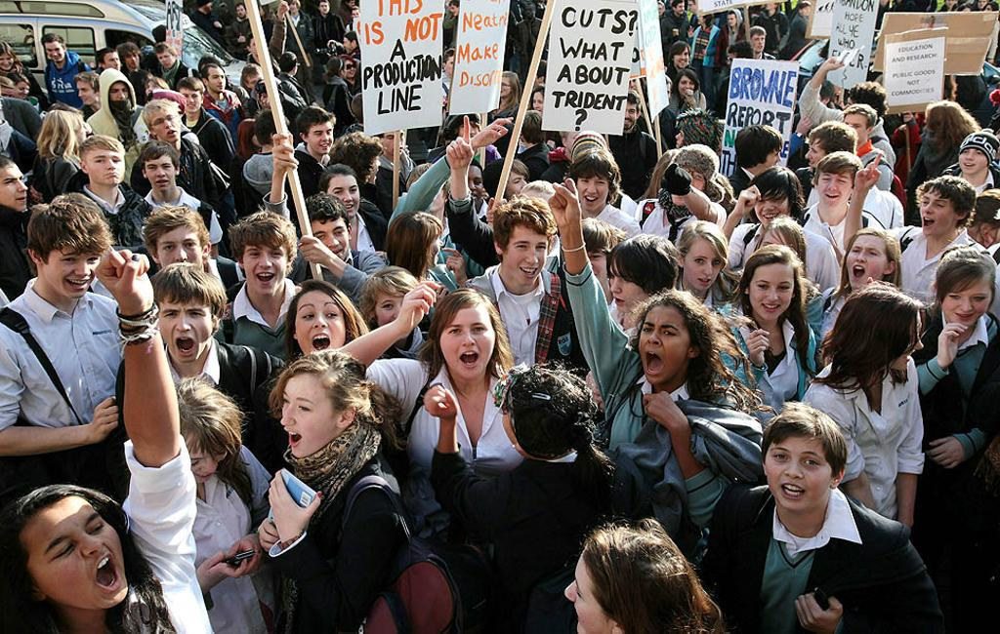

In [7]:
img = cv2.imread("2_Demonstration_Demonstration_Or_Protest_2_58.jpg")
# przygotowanie obrazów: monochromatycznego i RGB (cv2.imread() zwraca obraz w formacie BGR - inna kolejność składowych)
img_gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

# cv2_imshow(img)  # tylko w środowisku Colab
display(Image.fromarray(img_rgb))  # display() wymaga obrazu RGB (w przeciwieństwie do cv2.imshow(), która wymaga BGR)

## Kaskada Haara

Opracowano na podstawie: https://www.pyimagesearch.com/2021/04/05/opencv-face-detection-with-haar-cascades/

In [9]:
# utworzenie i inicjalizacja detektora
haar_detector = cv2.CascadeClassifier("haarcascade_frontalface_default.xml")

23


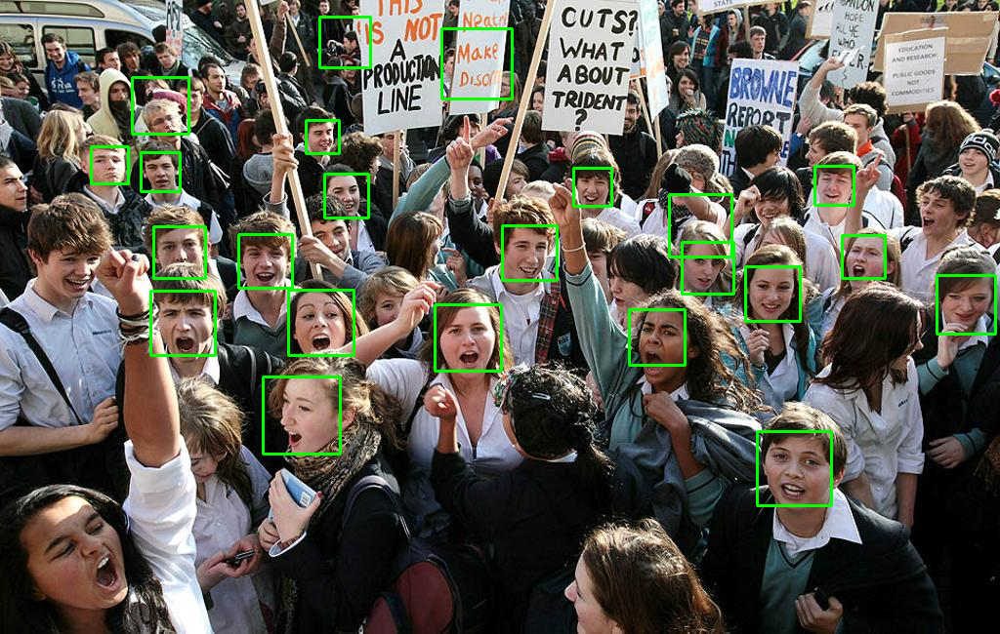

In [11]:
# wywołanie detektora dla określonego obrazu (img_gray)
# wynikiem jest lista prostokątów w formacie [x, y, width, height]
haar_results = haar_detector.detectMultiScale(img_gray, scaleFactor=1.05, minNeighbors=5, minSize=(30, 30), flags=cv2.CASCADE_SCALE_IMAGE)
print(len(haar_results))

# narysowanie wyników na kopii obrazu i wyświetlenie
img_haar = img_rgb.copy()
for (x, y, w, h) in haar_results:
  cv2.rectangle(img_haar, (x, y), (x+w, y+h), (0, 255, 0), 2)
display(Image.fromarray(img_haar))

## Histogram zorientowanych gradientów (HOG) z maszyną wektorów nośnych (SVM)

Opracowano na podstawie: https://www.pyimagesearch.com/2021/04/19/face-detection-with-dlib-hog-and-cnn/

In [13]:
# utworzenie i inicjalizacja detektora
hog_svm_detector = dlib.get_frontal_face_detector()

21


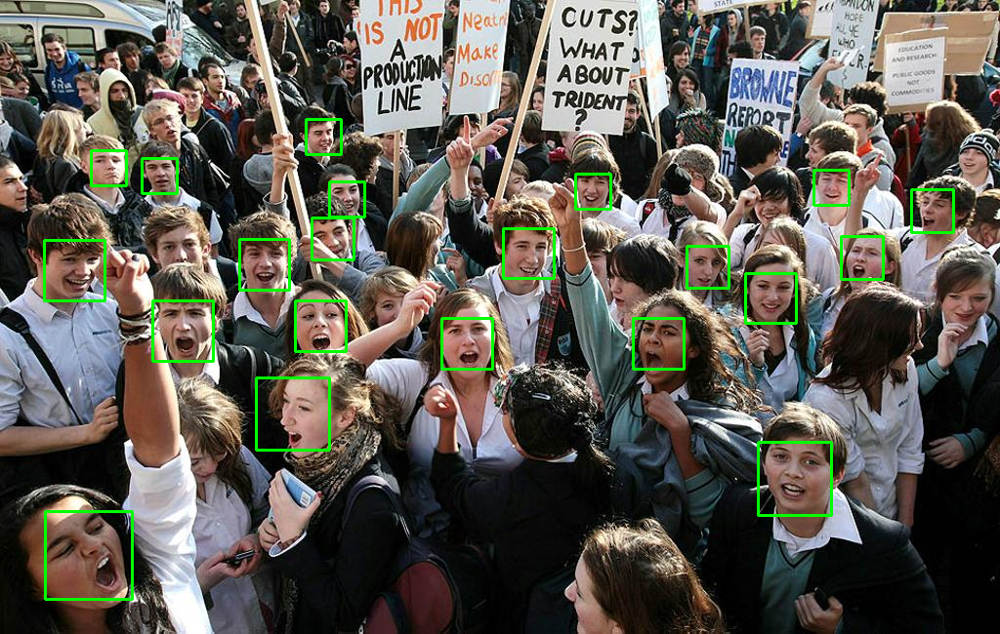

In [15]:
# wywołanie detektora dla określonego obrazu (img_rgb)
# wynikiem jest lista obiektów rectangle, zawierających współrzędne lewego górnego i prawego dolnego narożnika prostokąta
hog_svm_results = hog_svm_detector(img_rgb, 1)
print(len(hog_svm_results))

# narysowanie wyników na kopii obrazu i wyświetlenie
img_hog_svm = img_rgb.copy()
for rect in hog_svm_results:
	cv2.rectangle(img_hog_svm, (rect.left(), rect.top()), (rect.right(), rect.bottom()), (0, 255, 0), 2)
display(Image.fromarray(img_hog_svm))

## Splotowa sieć neuronowa (CNN) z biblioteki dlib

Opracowano na podstawie: https://www.pyimagesearch.com/2021/04/19/face-detection-with-dlib-hog-and-cnn/

In [16]:
# utworzenie i inicjalizacja detektora
cnn1_detector = dlib.cnn_face_detection_model_v1('mmod_human_face_detector.dat')

27


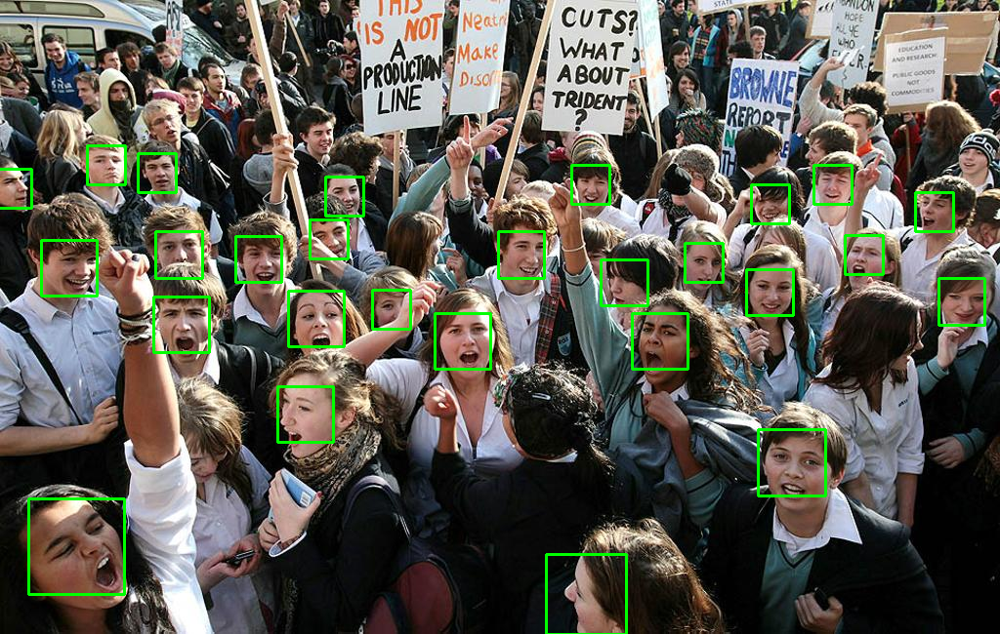

In [17]:
# wywołanie detektora dla określonego obrazu (img_rgb)
# wynikiem jest lista obiektów mmod_rectangle, zawierających m.in. pole rect ze współrzędnymi lewego górnego i prawego dolnego narożnika prostokąta
cnn1_results = cnn1_detector(img_rgb, 1)
print(len(cnn1_results))

# narysowanie wyników na kopii obrazu i wyświetlenie
img_cnn1 = img_rgb.copy()
for res in cnn1_results:
	rect = res.rect
	cv2.rectangle(img_cnn1, (rect.left(), rect.top()), (rect.right(), rect.bottom()), (0, 255, 0), 2)
display(Image.fromarray(img_cnn1))

## InsightFace - inna sieć neuronowa

Opracowano na podstawie: https://github.com/deepinsight/insightface/tree/master/python-package

In [18]:
# utworzenie i inicjalizacja detektora
model_name = 'buffalo_s'  # model: small (_s), medium (_m) lub large (_l)
insf_detector = insightface.app.FaceAnalysis(name=model_name, root='insightface',
                                             allowed_modules=['detection'], providers=['CPUExecutionProvider'])
insf_detector.prepare(ctx_id=0, det_size=(1024, 1024))

Applied providers: ['CPUExecutionProvider'], with options: {'CPUExecutionProvider': {}}
find model: insightface/models/buffalo_s/det_500m.onnx detection [1, 3, '?', '?'] 127.5 128.0
set det-size: (1024, 1024)


56


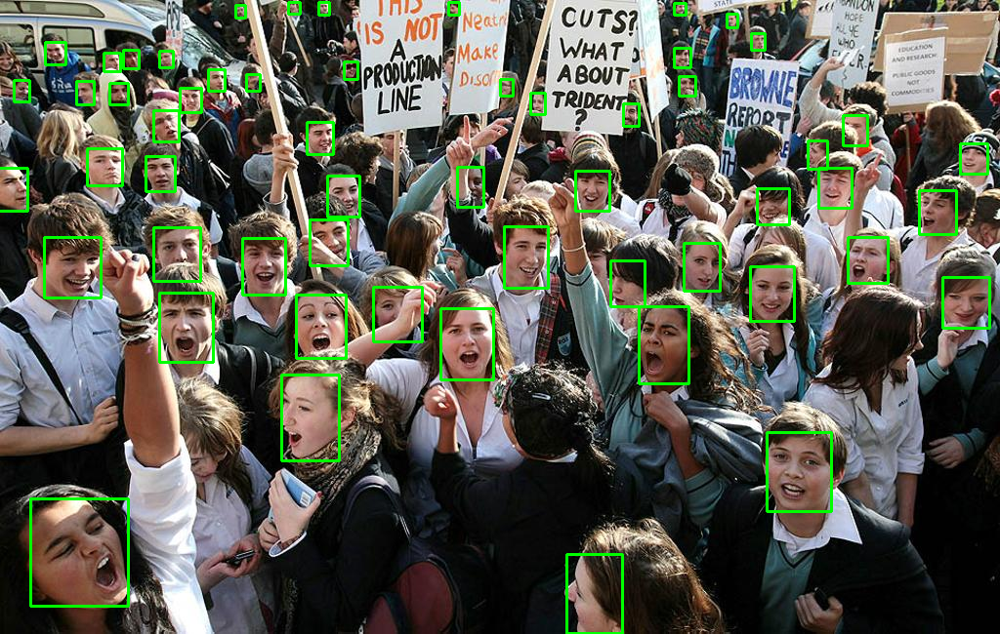

In [19]:
# wywołanie detektora dla określonego obrazu
# wynikiem jest lista obiektów, zawierających m.in. pole bbox ze współrzędnymi lewego górnego i prawego dolnego narożnika prostokąta
insf_results = insf_detector.get(img)
print(len(insf_results))

# narysowanie wyników na kopii obrazu i wyświetlenie
img_insf = img_rgb.copy()
for res in insf_results:
  # współrzędne prostokątów sa zapisane jako liczby rzeczywiste - konwersja do liczb całkowitych
  rect = res.bbox.round().astype(int)
  cv2.rectangle(img_insf, (rect[0], rect[1]), (rect[2], rect[3]), (0, 255, 0), 2)
display(Image.fromarray(img_insf))

Haar: GT = 101 ALL_DETECTIONS = 23 TP = 21 FN = 80 FP = 2 PRECISION = (TP - FP) / GT = 18,81%

HOG: GT = 101 ALL_DETECTIONS = 21 TP = 21 FN = 80 FP = 0 PRECISION = 20,79%

CNN: GT = 101 ALL_DETECTIONS = 27 TP = 27 FN = 74 FP = 0 PRECISION = 26,73%

InsightFace: GT = 101 ALL_DETECTIONS = 56 TP = 56 FN = 45 FP = 0 PRECISION = 55,45%

Według statystyk najskuteczniejszy jest InsightFace, później CNN, HOG i najgorszy jest Haar. Jeżeli chodzi o czas działania to Haar i HOG działały szybciej niż CNN i InsightFace. Zależnie od potrzeb (czas, jakość) należy wybrać odpowiedni detektor.

## Inne obrazy

### Obraz prosty

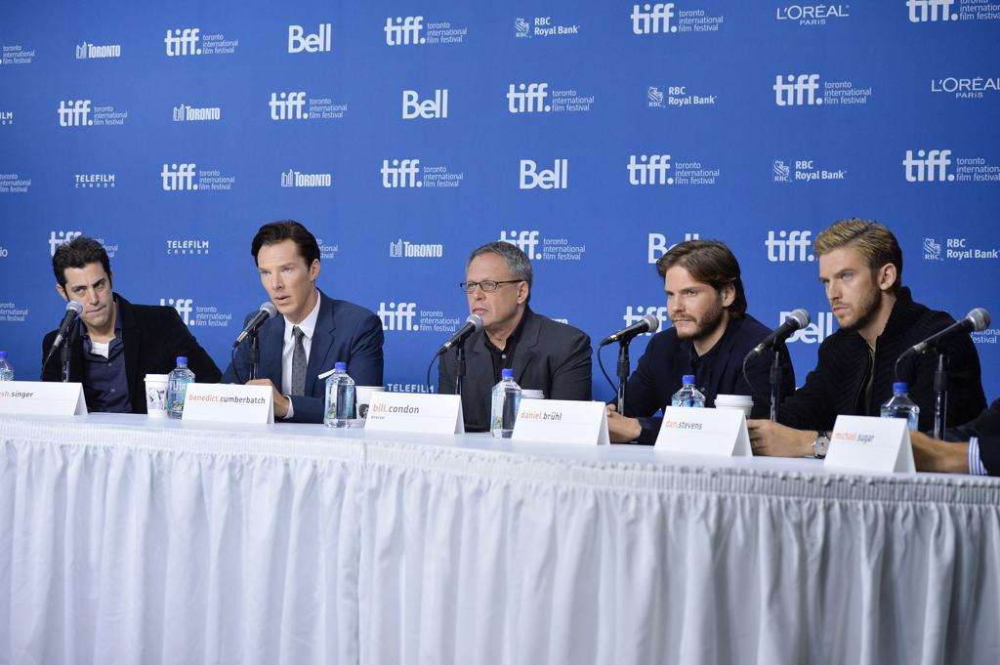

In [23]:
img = cv2.imread("9_Press_Conference_Press_Conference_9_45.jpg")
# przygotowanie obrazów: monochromatycznego i RGB (cv2.imread() zwraca obraz w formacie BGR - inna kolejność składowych)
img_gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

# cv2_imshow(img)  # tylko w środowisku Colab
display(Image.fromarray(img_rgb))  # display() wymaga obrazu RGB (w przeciwieństwie do cv2.imshow(), która wymaga BGR)

5


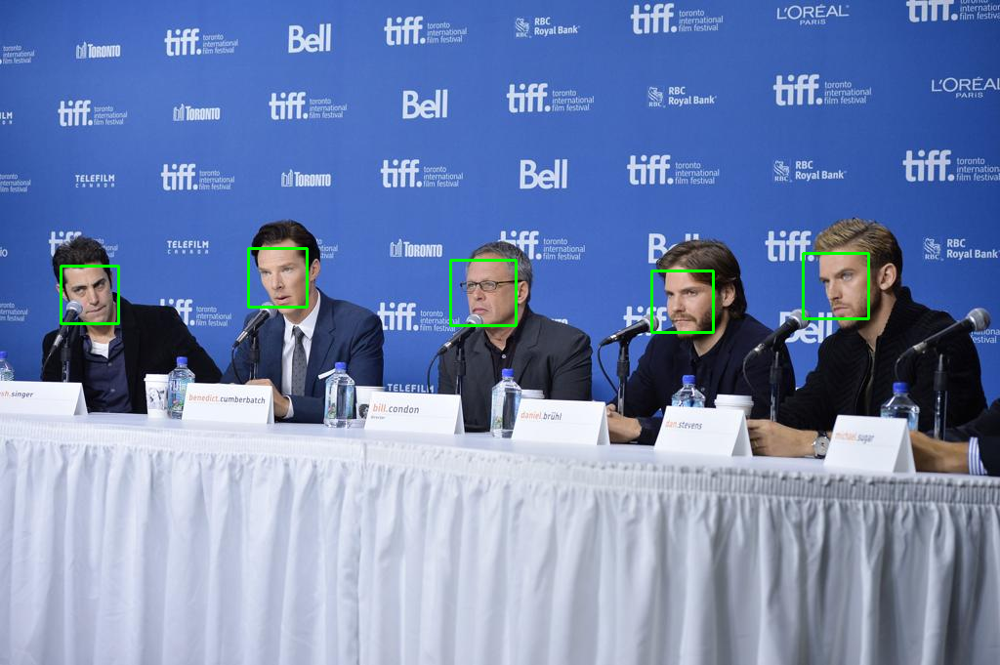

In [24]:
# wywołanie detektora dla określonego obrazu (img_gray)
# wynikiem jest lista prostokątów w formacie [x, y, width, height]
haar_results = haar_detector.detectMultiScale(img_gray, scaleFactor=1.05, minNeighbors=5, minSize=(30, 30), flags=cv2.CASCADE_SCALE_IMAGE)
print(len(haar_results))

# narysowanie wyników na kopii obrazu i wyświetlenie
img_haar = img_rgb.copy()
for (x, y, w, h) in haar_results:
  cv2.rectangle(img_haar, (x, y), (x+w, y+h), (0, 255, 0), 2)
display(Image.fromarray(img_haar))

5


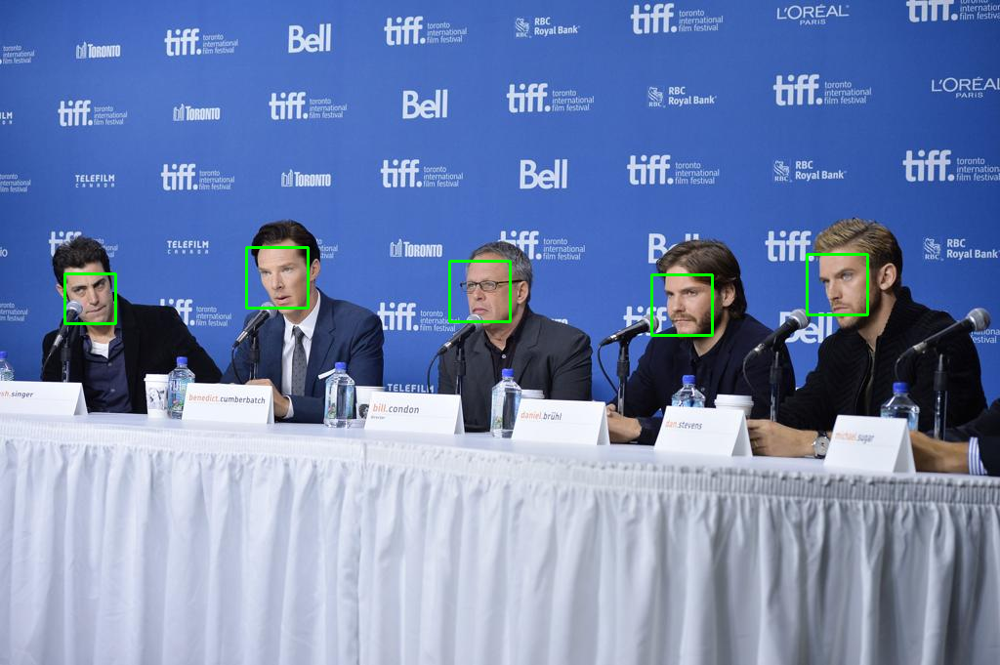

In [25]:
# wywołanie detektora dla określonego obrazu (img_rgb)
# wynikiem jest lista obiektów rectangle, zawierających współrzędne lewego górnego i prawego dolnego narożnika prostokąta
hog_svm_results = hog_svm_detector(img_rgb, 1)
print(len(hog_svm_results))

# narysowanie wyników na kopii obrazu i wyświetlenie
img_hog_svm = img_rgb.copy()
for rect in hog_svm_results:
	cv2.rectangle(img_hog_svm, (rect.left(), rect.top()), (rect.right(), rect.bottom()), (0, 255, 0), 2)
display(Image.fromarray(img_hog_svm))

5


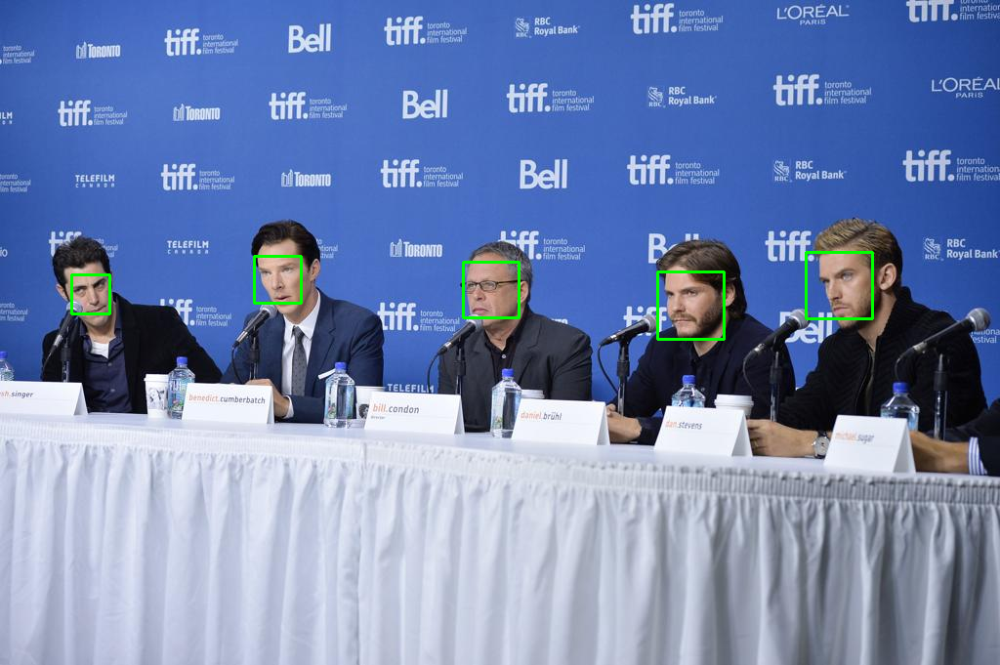

In [26]:
# wywołanie detektora dla określonego obrazu (img_rgb)
# wynikiem jest lista obiektów mmod_rectangle, zawierających m.in. pole rect ze współrzędnymi lewego górnego i prawego dolnego narożnika prostokąta
cnn1_results = cnn1_detector(img_rgb, 1)
print(len(cnn1_results))

# narysowanie wyników na kopii obrazu i wyświetlenie
img_cnn1 = img_rgb.copy()
for res in cnn1_results:
	rect = res.rect
	cv2.rectangle(img_cnn1, (rect.left(), rect.top()), (rect.right(), rect.bottom()), (0, 255, 0), 2)
display(Image.fromarray(img_cnn1))

5


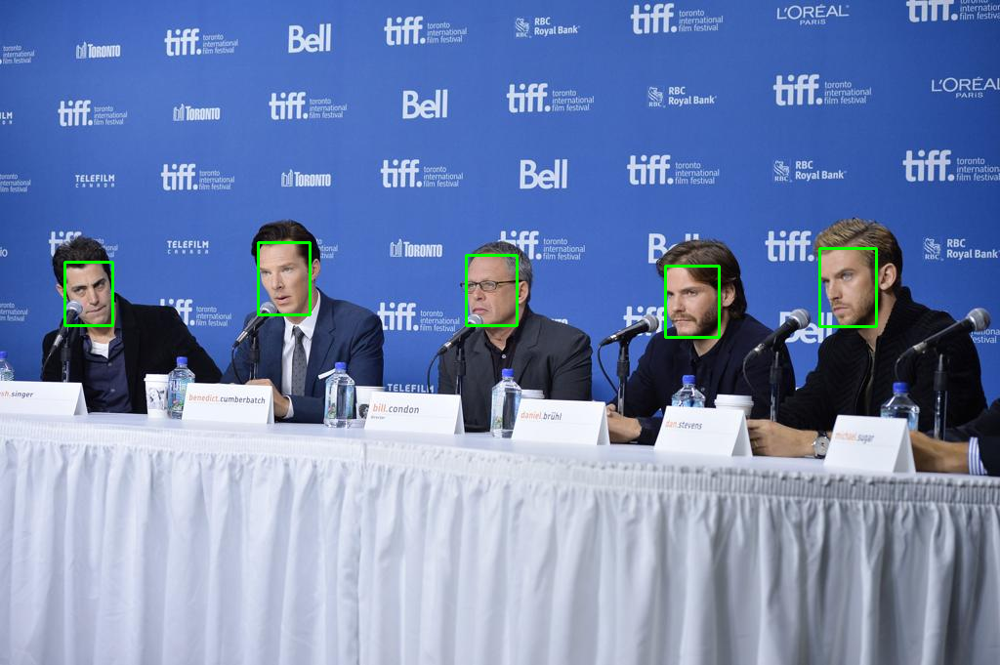

In [27]:
# wywołanie detektora dla określonego obrazu
# wynikiem jest lista obiektów, zawierających m.in. pole bbox ze współrzędnymi lewego górnego i prawego dolnego narożnika prostokąta
insf_results = insf_detector.get(img)
print(len(insf_results))

# narysowanie wyników na kopii obrazu i wyświetlenie
img_insf = img_rgb.copy()
for res in insf_results:
  # współrzędne prostokątów sa zapisane jako liczby rzeczywiste - konwersja do liczb całkowitych
  rect = res.bbox.round().astype(int)
  cv2.rectangle(img_insf, (rect[0], rect[1]), (rect[2], rect[3]), (0, 255, 0), 2)
display(Image.fromarray(img_insf))

## Obraz średni

Haar: GT = 5 ALL_DETECTIONS = 5 TP = 5 FN = 0 FP = 0 PRECISION = (TP - FP) / GT = 100%

HOG: GT = 5 ALL_DETECTIONS = 5 TP = 5 FN = 0 FP = 0 PRECISION = 100%

CNN: GT = 5 ALL_DETECTIONS = 5 TP = 5 FN = 0 FP = 0 PRECISION = 100%

InsightFace: GT = 5 ALL_DETECTIONS = 5 TP = 5 FN = 0 FP = 0 PRECISION = 100%

Z prostymi obrazami wszystkie detektory radzą sobie świetnie, więc lepiej wybrać ten, który zabiera mniej czasu i zasobów.

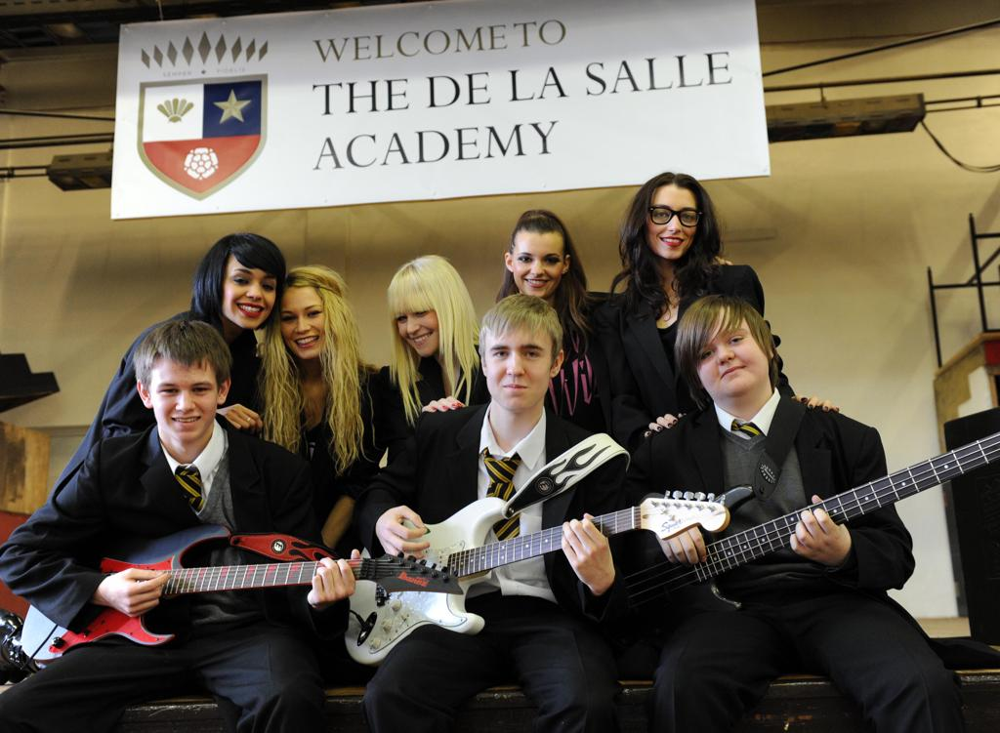

In [28]:
img = cv2.imread("0_Parade_Parade_0_887.jpg")
# przygotowanie obrazów: monochromatycznego i RGB (cv2.imread() zwraca obraz w formacie BGR - inna kolejność składowych)
img_gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

# cv2_imshow(img)  # tylko w środowisku Colab
display(Image.fromarray(img_rgb))  # display() wymaga obrazu RGB (w przeciwieństwie do cv2.imshow(), która wymaga BGR)

9


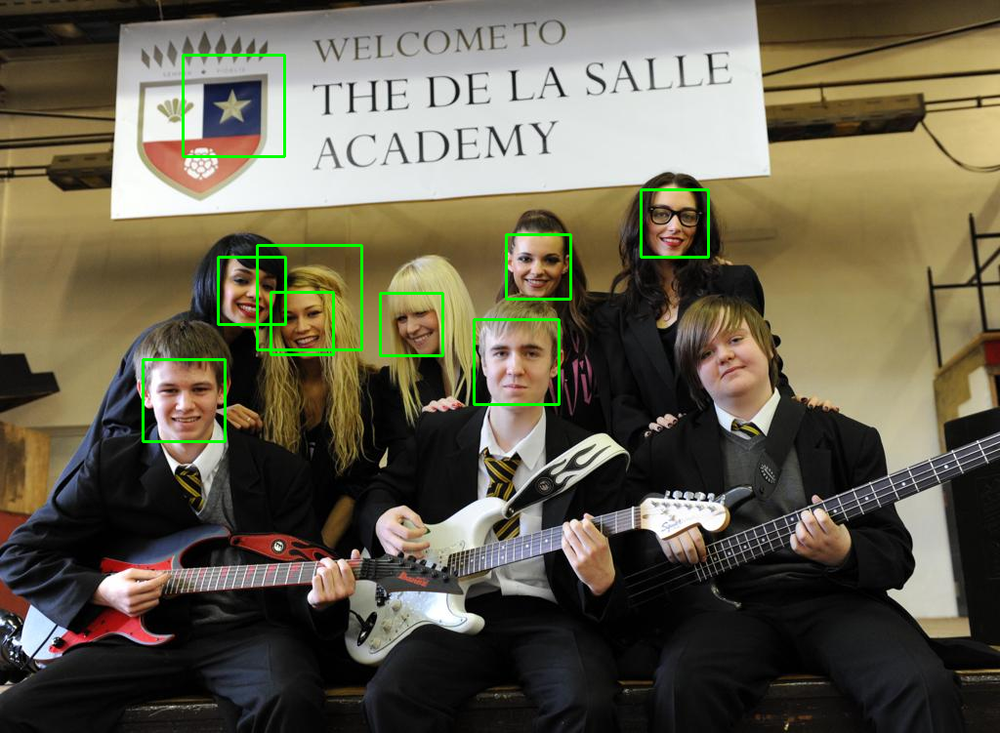

In [29]:
# wywołanie detektora dla określonego obrazu (img_gray)
# wynikiem jest lista prostokątów w formacie [x, y, width, height]
haar_results = haar_detector.detectMultiScale(img_gray, scaleFactor=1.05, minNeighbors=5, minSize=(30, 30), flags=cv2.CASCADE_SCALE_IMAGE)
print(len(haar_results))

# narysowanie wyników na kopii obrazu i wyświetlenie
img_haar = img_rgb.copy()
for (x, y, w, h) in haar_results:
  cv2.rectangle(img_haar, (x, y), (x+w, y+h), (0, 255, 0), 2)
display(Image.fromarray(img_haar))

8


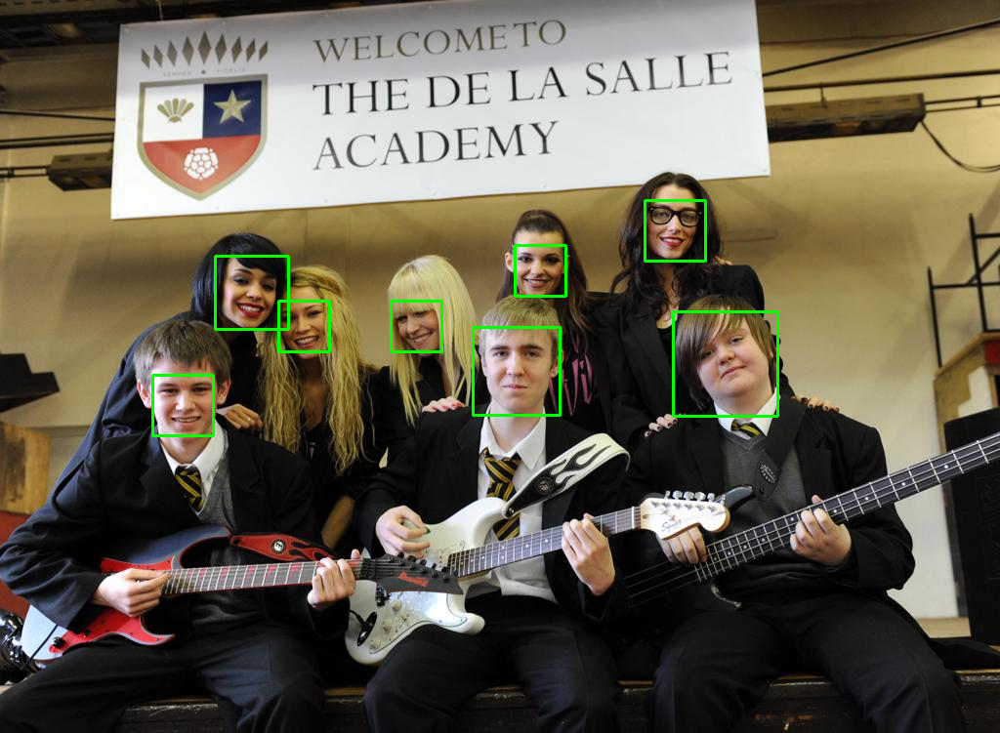

In [30]:
# wywołanie detektora dla określonego obrazu (img_rgb)
# wynikiem jest lista obiektów rectangle, zawierających współrzędne lewego górnego i prawego dolnego narożnika prostokąta
hog_svm_results = hog_svm_detector(img_rgb, 1)
print(len(hog_svm_results))

# narysowanie wyników na kopii obrazu i wyświetlenie
img_hog_svm = img_rgb.copy()
for rect in hog_svm_results:
	cv2.rectangle(img_hog_svm, (rect.left(), rect.top()), (rect.right(), rect.bottom()), (0, 255, 0), 2)
display(Image.fromarray(img_hog_svm))

8


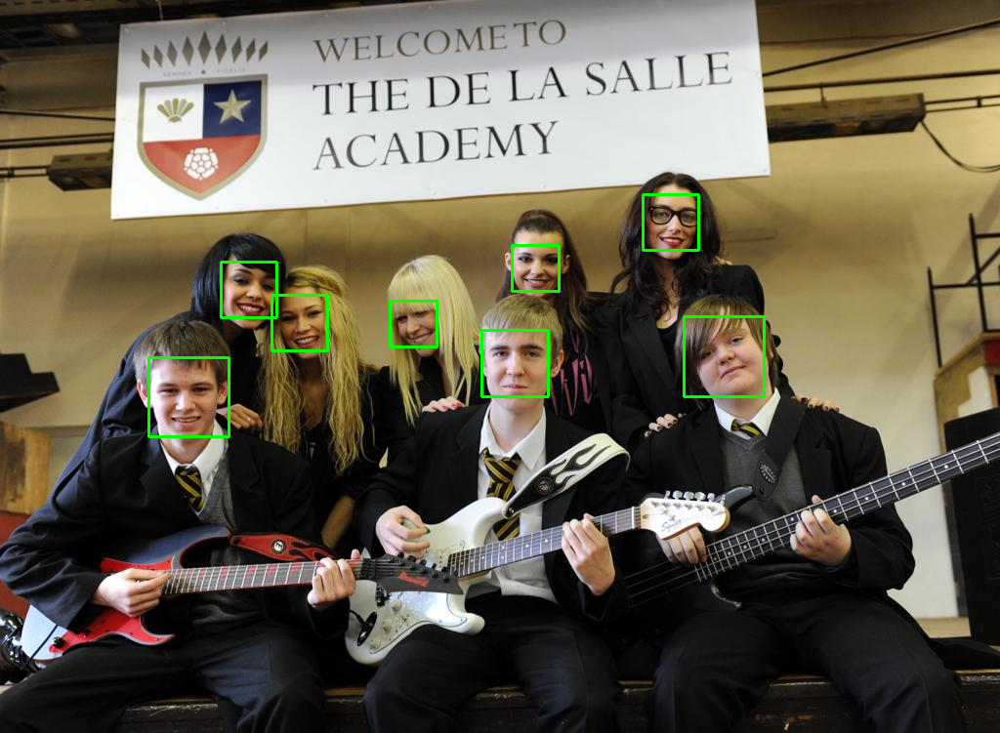

In [31]:
# wywołanie detektora dla określonego obrazu (img_rgb)
# wynikiem jest lista obiektów mmod_rectangle, zawierających m.in. pole rect ze współrzędnymi lewego górnego i prawego dolnego narożnika prostokąta
cnn1_results = cnn1_detector(img_rgb, 1)
print(len(cnn1_results))

# narysowanie wyników na kopii obrazu i wyświetlenie
img_cnn1 = img_rgb.copy()
for res in cnn1_results:
	rect = res.rect
	cv2.rectangle(img_cnn1, (rect.left(), rect.top()), (rect.right(), rect.bottom()), (0, 255, 0), 2)
display(Image.fromarray(img_cnn1))

8


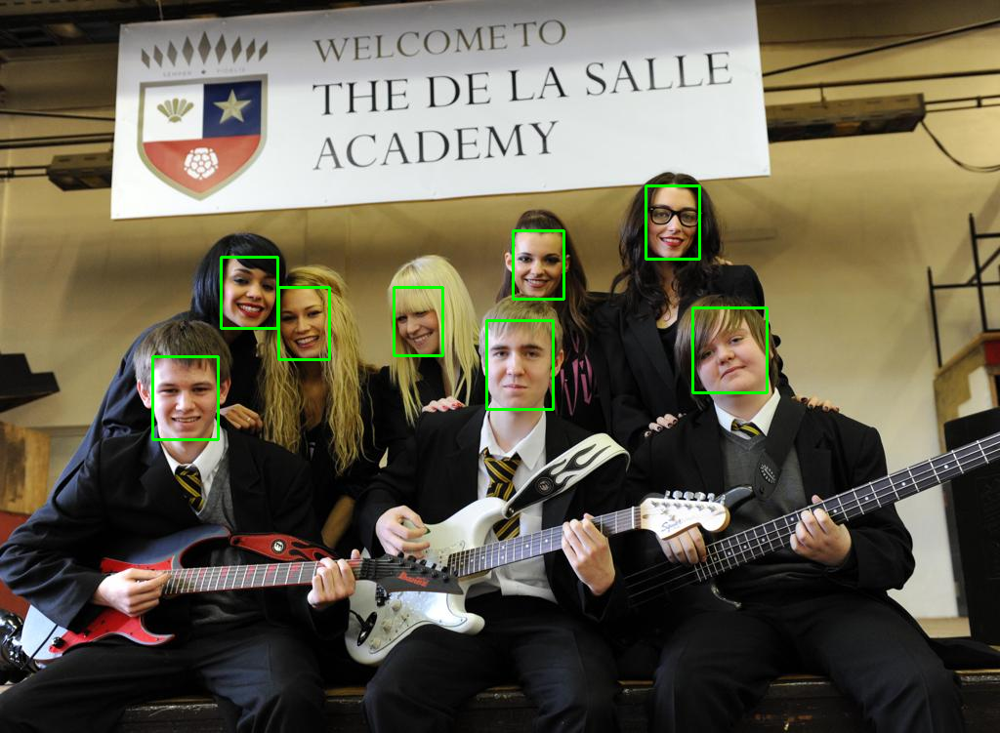

In [32]:
# wywołanie detektora dla określonego obrazu
# wynikiem jest lista obiektów, zawierających m.in. pole bbox ze współrzędnymi lewego górnego i prawego dolnego narożnika prostokąta
insf_results = insf_detector.get(img)
print(len(insf_results))

# narysowanie wyników na kopii obrazu i wyświetlenie
img_insf = img_rgb.copy()
for res in insf_results:
  # współrzędne prostokątów sa zapisane jako liczby rzeczywiste - konwersja do liczb całkowitych
  rect = res.bbox.round().astype(int)
  cv2.rectangle(img_insf, (rect[0], rect[1]), (rect[2], rect[3]), (0, 255, 0), 2)
display(Image.fromarray(img_insf))

Haar: GT = 8 ALL_DETECTIONS = 9 TP = 7 FN = 1 FP = 2 PRECISION = (TP - FP) / GT = 62,5%

HOG: GT = 8 ALL_DETECTIONS = 8 TP = 8 FN = 0 FP = 0 PRECISION = 100%

CNN: GT = 8 ALL_DETECTIONS = 8 TP = 8 FN = 0 FP = 0 PRECISION = 100%

InsightFace: GT = 8 ALL_DETECTIONS = 8 TP = 8 FN = 0 FP = 0 PRECISION = 100%

Ze średnimi obrazami Haar nie radzi sobie najlepiej, ale inne detektory dają radę, więc znowu lepiej postwić na czas i ilość zasobów.

### Obraz trudny

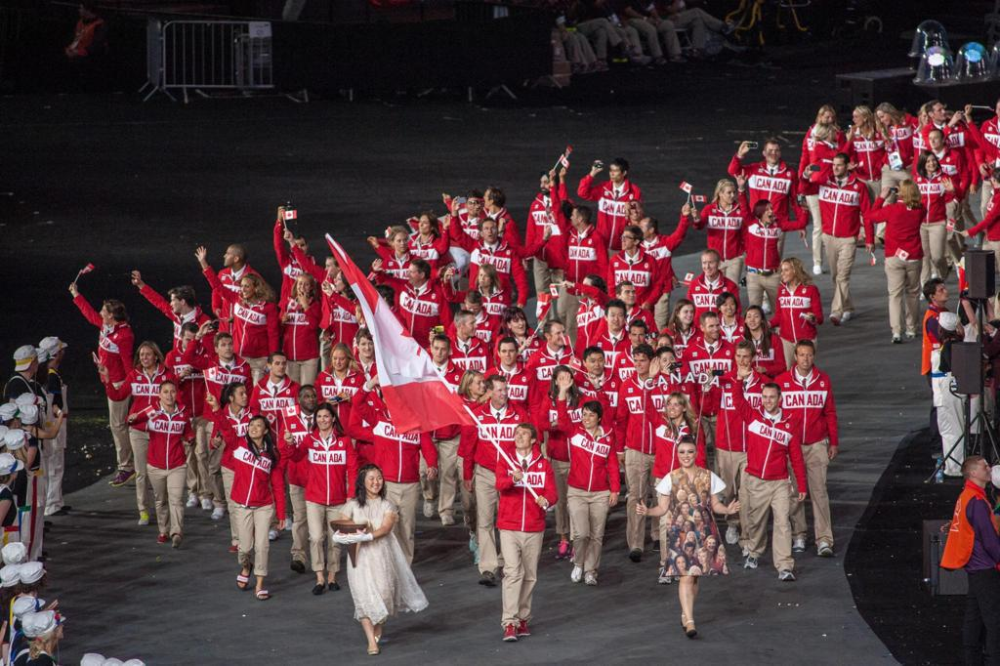

In [33]:
img = cv2.imread("17_Ceremony_Ceremony_17_44.jpg")
# przygotowanie obrazów: monochromatycznego i RGB (cv2.imread() zwraca obraz w formacie BGR - inna kolejność składowych)
img_gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

# cv2_imshow(img)  # tylko w środowisku Colab
display(Image.fromarray(img_rgb))  # display() wymaga obrazu RGB (w przeciwieństwie do cv2.imshow(), która wymaga BGR)

2


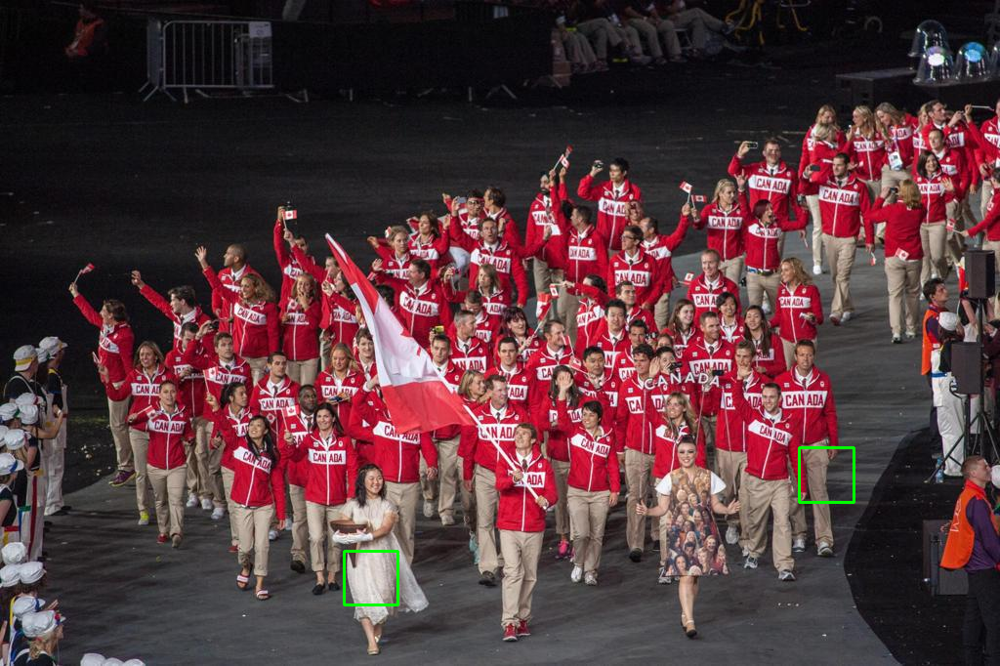

In [34]:
# wywołanie detektora dla określonego obrazu (img_gray)
# wynikiem jest lista prostokątów w formacie [x, y, width, height]
haar_results = haar_detector.detectMultiScale(img_gray, scaleFactor=1.05, minNeighbors=5, minSize=(30, 30), flags=cv2.CASCADE_SCALE_IMAGE)
print(len(haar_results))

# narysowanie wyników na kopii obrazu i wyświetlenie
img_haar = img_rgb.copy()
for (x, y, w, h) in haar_results:
  cv2.rectangle(img_haar, (x, y), (x+w, y+h), (0, 255, 0), 2)
display(Image.fromarray(img_haar))

0


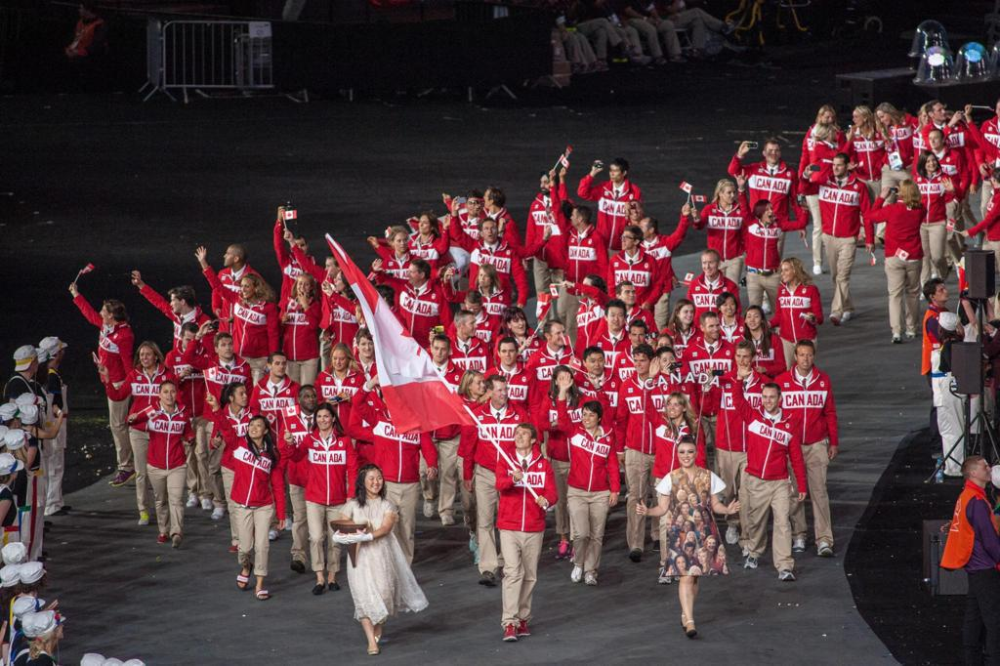

In [35]:
# wywołanie detektora dla określonego obrazu (img_rgb)
# wynikiem jest lista obiektów rectangle, zawierających współrzędne lewego górnego i prawego dolnego narożnika prostokąta
hog_svm_results = hog_svm_detector(img_rgb, 1)
print(len(hog_svm_results))

# narysowanie wyników na kopii obrazu i wyświetlenie
img_hog_svm = img_rgb.copy()
for rect in hog_svm_results:
	cv2.rectangle(img_hog_svm, (rect.left(), rect.top()), (rect.right(), rect.bottom()), (0, 255, 0), 2)
display(Image.fromarray(img_hog_svm))

0


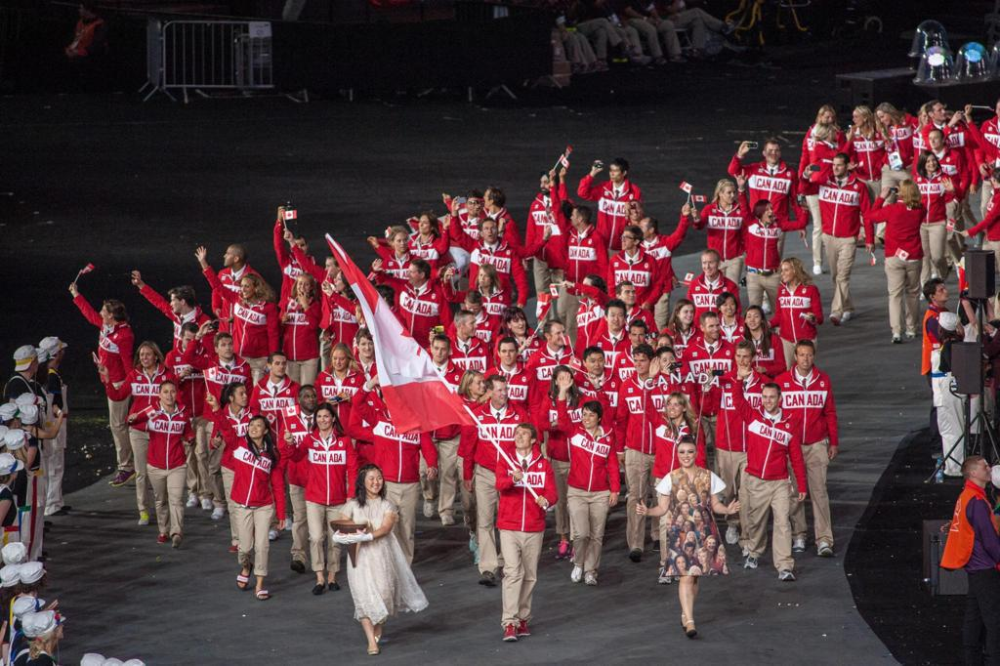

In [36]:
# wywołanie detektora dla określonego obrazu (img_rgb)
# wynikiem jest lista obiektów mmod_rectangle, zawierających m.in. pole rect ze współrzędnymi lewego górnego i prawego dolnego narożnika prostokąta
cnn1_results = cnn1_detector(img_rgb, 1)
print(len(cnn1_results))

# narysowanie wyników na kopii obrazu i wyświetlenie
img_cnn1 = img_rgb.copy()
for res in cnn1_results:
	rect = res.rect
	cv2.rectangle(img_cnn1, (rect.left(), rect.top()), (rect.right(), rect.bottom()), (0, 255, 0), 2)
display(Image.fromarray(img_cnn1))

64


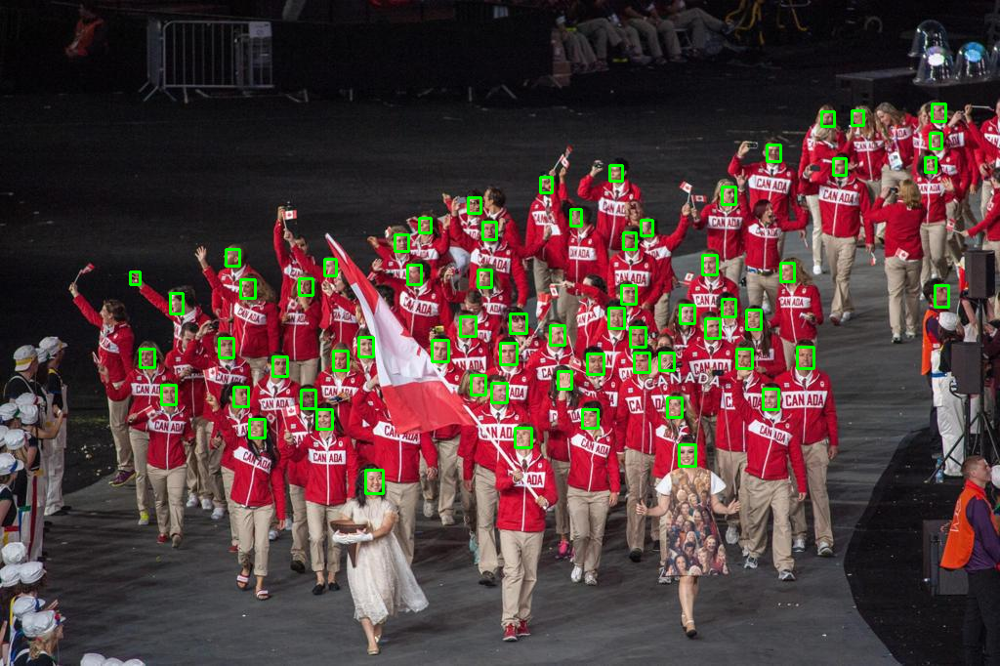

In [37]:
# wywołanie detektora dla określonego obrazu
# wynikiem jest lista obiektów, zawierających m.in. pole bbox ze współrzędnymi lewego górnego i prawego dolnego narożnika prostokąta
insf_results = insf_detector.get(img)
print(len(insf_results))

# narysowanie wyników na kopii obrazu i wyświetlenie
img_insf = img_rgb.copy()
for res in insf_results:
  # współrzędne prostokątów sa zapisane jako liczby rzeczywiste - konwersja do liczb całkowitych
  rect = res.bbox.round().astype(int)
  cv2.rectangle(img_insf, (rect[0], rect[1]), (rect[2], rect[3]), (0, 255, 0), 2)
display(Image.fromarray(img_insf))

Haar: GT = 73 ALL_DETECTIONS = 2 TP = 0 FN = 73 FP = 2 PRECISION = (TP - FP) / GT = 0%

HOG: GT = 73 ALL_DETECTIONS = 0 TP = 0 FN = 73 FP = 0 PRECISION = 0%

CNN: GT = 73 ALL_DETECTIONS = 0 TP = 0 FN = 73 FP = 0 PRECISION = 0%

InsightFace: GT = 73 ALL_DETECTIONS = 64 TP = 63 FN = 10 FP = 1 PRECISION = 84,93%

Z tym trudnym obrazem poradził sobie tylko InsightFace. Inne detektory kompletnie zawiodły. Można śmiało wysunąć wniosek, że jest on najdokładniejszy.

## Suma statystyk ze wszystkich obrazów

Haar: GT = 187 ALL_DETECTIONS = 39 TP = 33 FN = 154 FP = 6 PRECISION = (TP - FP) / GT = 14,43%

HOG: GT = 187 ALL_DETECTIONS = 34 TP = 34 FN = 153 FP = 0 PRECISION = 18,18%

CNN: GT = 187 ALL_DETECTIONS = 40 TP = 40 FN = 147 FP = 0 PRECISION = 21,39%

InsightFace: GT = 187 ALL_DETECTIONS = 133 TP = 132 FN = 55 FP = 1 PRECISION = 70,05%

Ułożone w kolejności rosnącej pod względem skuteczności detektory: Haar < HOG < CNN < InsightFace. InsightFace jest zdecydowanie najlepszy, jego twarze są wykrywane dokładnie, myli się rzadko, wykrywa dużo. HOG i CNN wykrywają sporo, ale za to są 'bezpieczne', czyli praktycznie nie wykrywają złych elementów (statystyka FP), a Haar jest najmniej dokładny, bo mało wykrywa i często się myli.

## Zmiana parametrów detektorów

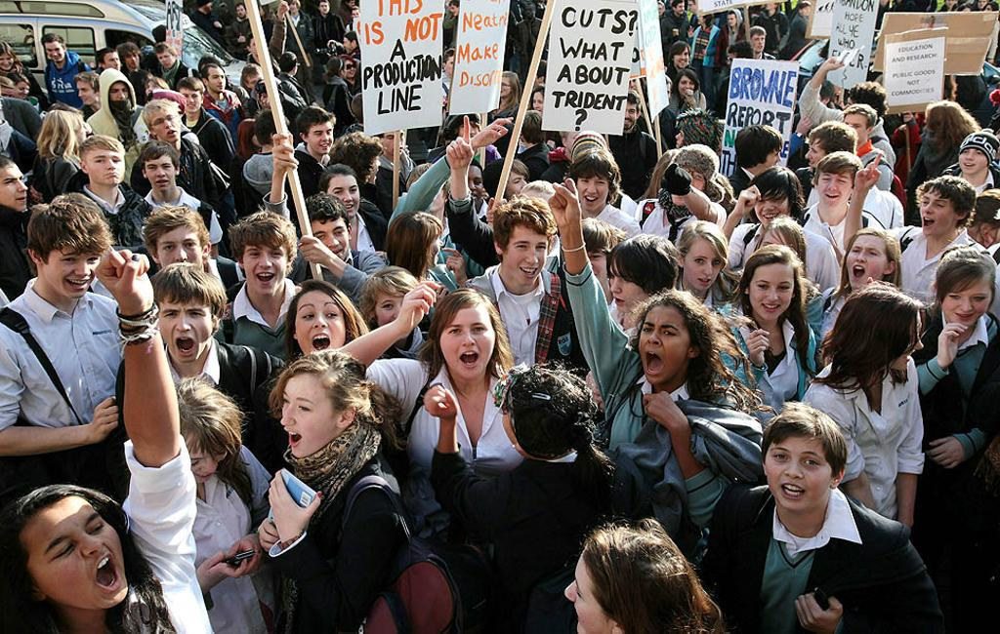

In [38]:
img = cv2.imread("2_Demonstration_Demonstration_Or_Protest_2_58.jpg")
# przygotowanie obrazów: monochromatycznego i RGB (cv2.imread() zwraca obraz w formacie BGR - inna kolejność składowych)
img_gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

# cv2_imshow(img)  # tylko w środowisku Colab
display(Image.fromarray(img_rgb))  # display() wymaga obrazu RGB (w przeciwieństwie do cv2.imshow(), która wymaga BGR)

### HOG

6


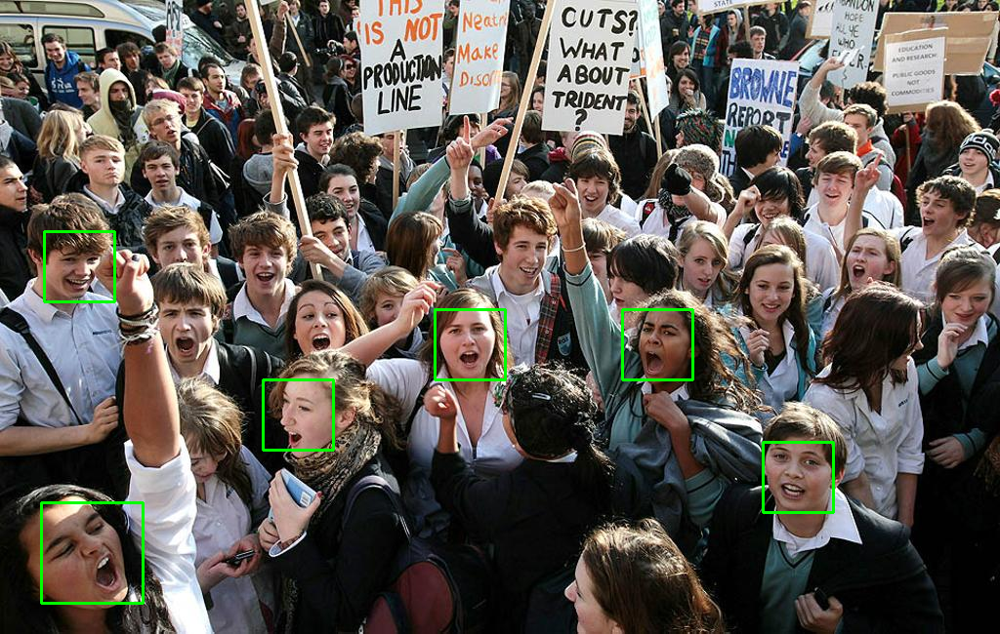

In [39]:
# wywołanie detektora dla określonego obrazu (img_rgb)
# wynikiem jest lista obiektów rectangle, zawierających współrzędne lewego górnego i prawego dolnego narożnika prostokąta
hog_svm_results = hog_svm_detector(img_rgb, 0)
print(len(hog_svm_results))

# narysowanie wyników na kopii obrazu i wyświetlenie
img_hog_svm = img_rgb.copy()
for rect in hog_svm_results:
	cv2.rectangle(img_hog_svm, (rect.left(), rect.top()), (rect.right(), rect.bottom()), (0, 255, 0), 2)
display(Image.fromarray(img_hog_svm))

29


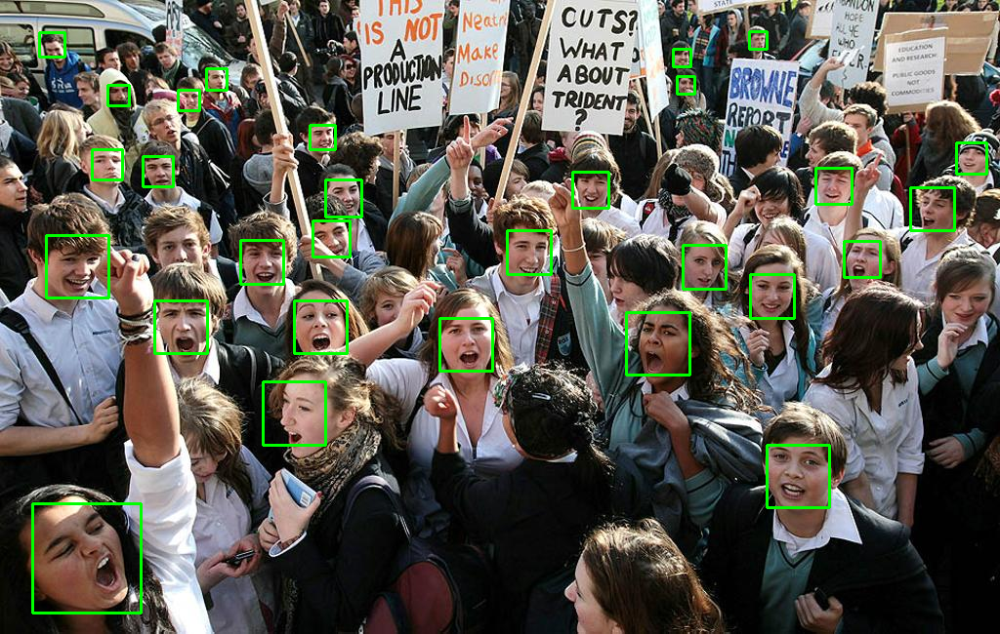

In [40]:
# wywołanie detektora dla określonego obrazu (img_rgb)
# wynikiem jest lista obiektów rectangle, zawierających współrzędne lewego górnego i prawego dolnego narożnika prostokąta
hog_svm_results = hog_svm_detector(img_rgb, 2)
print(len(hog_svm_results))

# narysowanie wyników na kopii obrazu i wyświetlenie
img_hog_svm = img_rgb.copy()
for rect in hog_svm_results:
	cv2.rectangle(img_hog_svm, (rect.left(), rect.top()), (rect.right(), rect.bottom()), (0, 255, 0), 2)
display(Image.fromarray(img_hog_svm))

### CNN

4


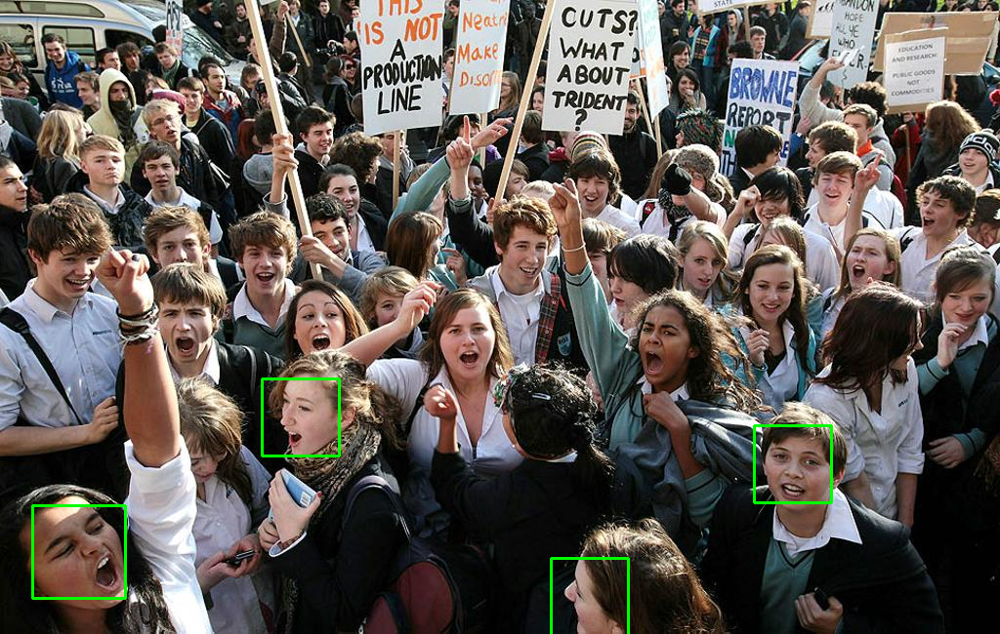

In [41]:
# wywołanie detektora dla określonego obrazu (img_rgb)
# wynikiem jest lista obiektów mmod_rectangle, zawierających m.in. pole rect ze współrzędnymi lewego górnego i prawego dolnego narożnika prostokąta
cnn1_results = cnn1_detector(img_rgb, 0)
print(len(cnn1_results))

# narysowanie wyników na kopii obrazu i wyświetlenie
img_cnn1 = img_rgb.copy()
for res in cnn1_results:
	rect = res.rect
	cv2.rectangle(img_cnn1, (rect.left(), rect.top()), (rect.right(), rect.bottom()), (0, 255, 0), 2)
display(Image.fromarray(img_cnn1))

37


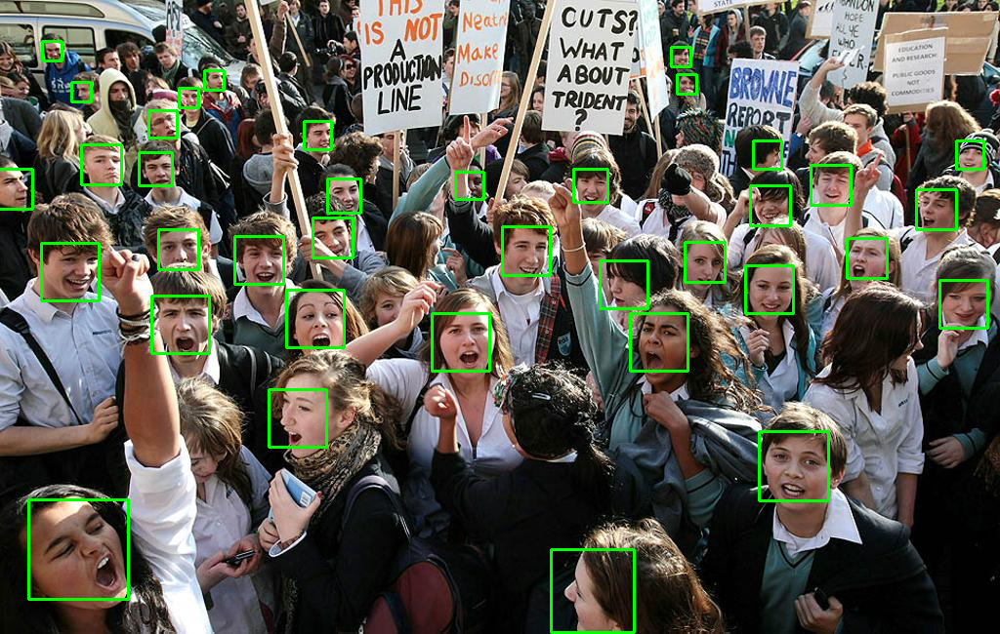

In [42]:
# wywołanie detektora dla określonego obrazu (img_rgb)
# wynikiem jest lista obiektów mmod_rectangle, zawierających m.in. pole rect ze współrzędnymi lewego górnego i prawego dolnego narożnika prostokąta
cnn1_results = cnn1_detector(img_rgb, 2)
print(len(cnn1_results))

# narysowanie wyników na kopii obrazu i wyświetlenie
img_cnn1 = img_rgb.copy()
for res in cnn1_results:
	rect = res.rect
	cv2.rectangle(img_cnn1, (rect.left(), rect.top()), (rect.right(), rect.bottom()), (0, 255, 0), 2)
display(Image.fromarray(img_cnn1))

### InsightFace

In [51]:
# utworzenie i inicjalizacja detektora
model_name = 'buffalo_s'  # model: small (_s), medium (_m) lub large (_l)
insf_detector = insightface.app.FaceAnalysis(name=model_name, root='insightface',
                                             allowed_modules=['detection'], providers=['CPUExecutionProvider'])
insf_detector.prepare(ctx_id=0, det_size=(512, 512))

Applied providers: ['CPUExecutionProvider'], with options: {'CPUExecutionProvider': {}}
find model: insightface/models/buffalo_s/det_500m.onnx detection [1, 3, '?', '?'] 127.5 128.0
set det-size: (512, 512)


41


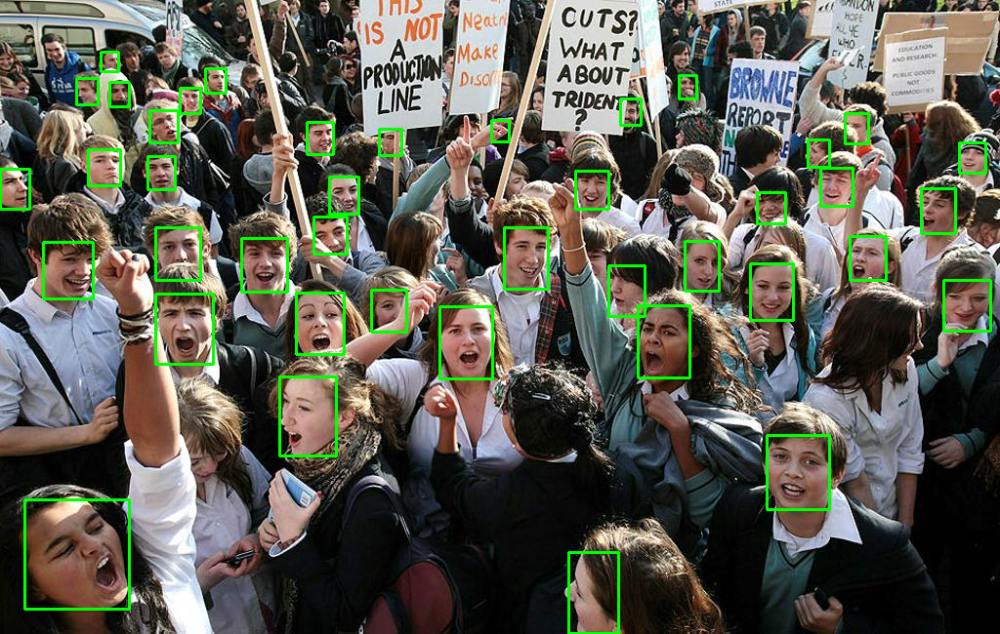

In [52]:
# wywołanie detektora dla określonego obrazu
# wynikiem jest lista obiektów, zawierających m.in. pole bbox ze współrzędnymi lewego górnego i prawego dolnego narożnika prostokąta
insf_results = insf_detector.get(img)
print(len(insf_results))

# narysowanie wyników na kopii obrazu i wyświetlenie
img_insf = img_rgb.copy()
for res in insf_results:
  # współrzędne prostokątów sa zapisane jako liczby rzeczywiste - konwersja do liczb całkowitych
  rect = res.bbox.round().astype(int)
  cv2.rectangle(img_insf, (rect[0], rect[1]), (rect[2], rect[3]), (0, 255, 0), 2)
display(Image.fromarray(img_insf))

In [53]:
# utworzenie i inicjalizacja detektora
model_name = 'buffalo_s'  # model: small (_s), medium (_m) lub large (_l)
insf_detector = insightface.app.FaceAnalysis(name=model_name, root='insightface',
                                             allowed_modules=['detection'], providers=['CPUExecutionProvider'])
insf_detector.prepare(ctx_id=0, det_size=(2048, 2048))

Applied providers: ['CPUExecutionProvider'], with options: {'CPUExecutionProvider': {}}
find model: insightface/models/buffalo_s/det_500m.onnx detection [1, 3, '?', '?'] 127.5 128.0
set det-size: (2048, 2048)


64


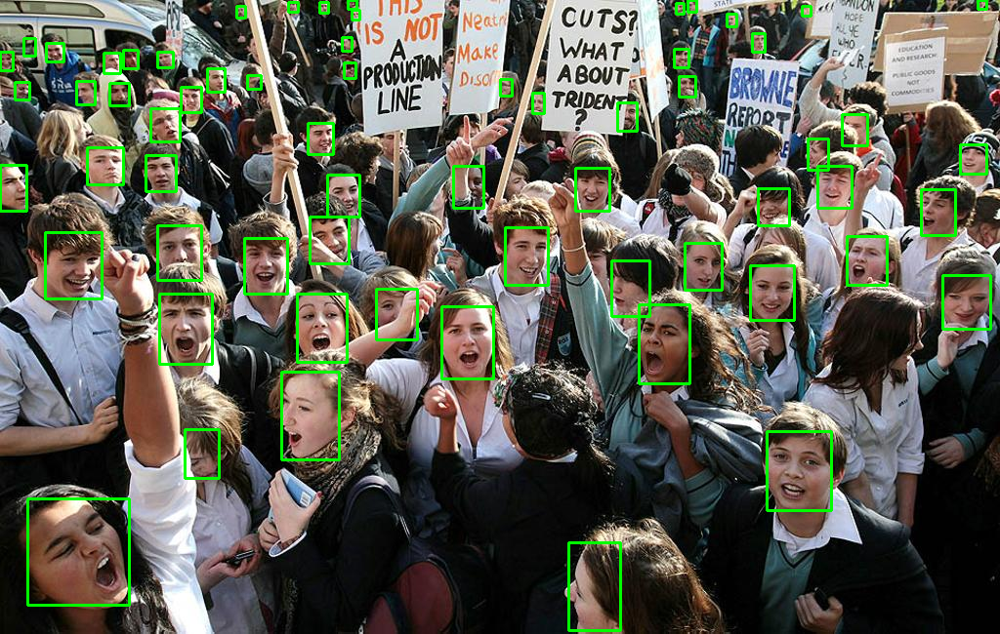

In [54]:
# wywołanie detektora dla określonego obrazu
# wynikiem jest lista obiektów, zawierających m.in. pole bbox ze współrzędnymi lewego górnego i prawego dolnego narożnika prostokąta
insf_results = insf_detector.get(img)
print(len(insf_results))

# narysowanie wyników na kopii obrazu i wyświetlenie
img_insf = img_rgb.copy()
for res in insf_results:
  # współrzędne prostokątów sa zapisane jako liczby rzeczywiste - konwersja do liczb całkowitych
  rect = res.bbox.round().astype(int)
  cv2.rectangle(img_insf, (rect[0], rect[1]), (rect[2], rect[3]), (0, 255, 0), 2)
display(Image.fromarray(img_insf))

### Statystyki przed zmianą:

HOG: GT = 101 ALL_DETECTIONS = 21 TP = 21 FN = 80 FP = 0 PRECISION = (TP - FP) / GT = 20,79%

CNN: GT = 101 ALL_DETECTIONS = 27 TP = 27 FN = 74 FP = 0 PRECISION = 26,73%

InsightFace: GT = 101 ALL_DETECTIONS = 56 TP = 56 FN = 45 FP = 0 PRECISION = 55,45%

### Statystyki po zmniejszeniu rozmiaru:

HOG: GT = 101 ALL_DETECTIONS = 6 TP = 6 FN = 95 FP = 0 PRECISION = (TP - FP) / GT = 5,94%

CNN: GT = 101 ALL_DETECTIONS = 4 TP = 4 FN = 97 FP = 0 PRECISION = 3,96%

InsightFace: GT = 101 ALL_DETECTIONS = 41 TP = 40 FN = 61 FP = 1 PRECISION = 38,61%

### Statystyki po zwiększeniu rozmiaru:

HOG: GT = 101 ALL_DETECTIONS = 29 TP = 29 FN = 72 FP = 0 PRECISION = (TP - FP) / GT = 28,71%

CNN: GT = 101 ALL_DETECTIONS = 37 TP = 37 FN = 64 FP = 0 PRECISION = 36,63%

InsightFace: GT = 101 ALL_DETECTIONS = 64 TP = 63 FN = 38 FP = 1 PRECISION = 61,39%

Zwiększenie rozmiaru generalnie zwiększa ilość wykrywanych twarzy i dokładność, ponieważ na większym obrazie można łatwiej zobaczyć twarz (porównać piksele) niż na małym. W zmniejszonym obrazie CNN był najgorszy, a w zwiększonym - HOG. InsightFace był najlepszy w obu przypadkach.